In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
import tensorflow as tf
import torch.optim as optim
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
# Image completion
import os
if os.path.exists('dog.jpg'):
    print('dog.jpg exists')
else:
    !wget https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg -O dog.jpg

dog.jpg exists


In [3]:
# Read in a image from torchvision
import torchvision
img = torchvision.io.read_image("dog.jpg")
print(img.shape)

torch.Size([3, 1365, 2048])


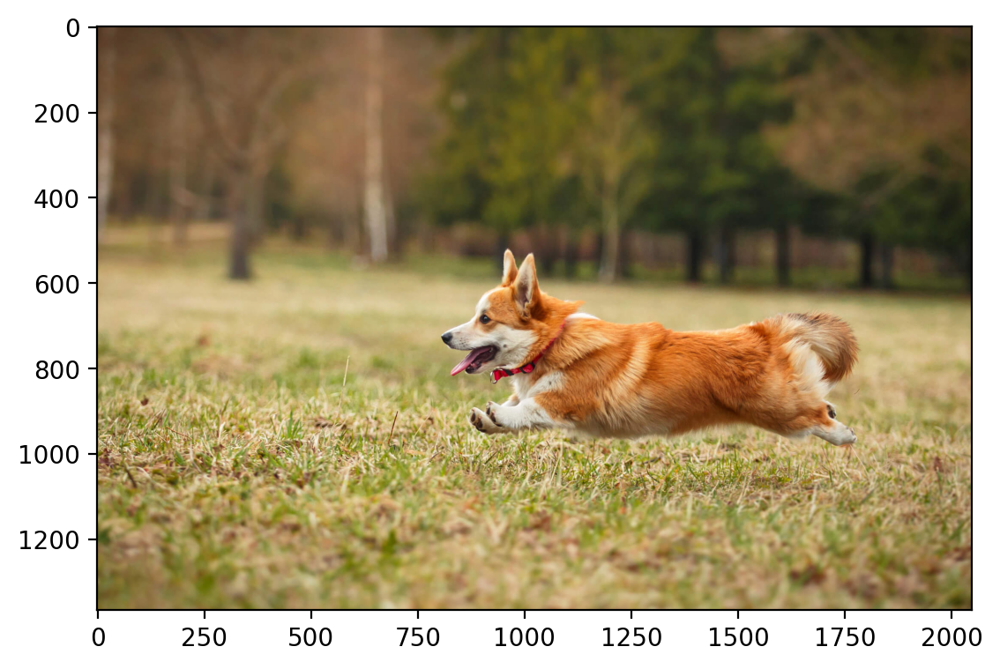

In [4]:
plt.imshow(img.permute(1,2,0).numpy().astype('uint8'))

In [5]:
# Extract patches surrounding the missing patch
def extract_patches(img,top_left,hight,width):
    x,y = top_left
    patches = torchvision.transforms.functional.crop(img,y,x,hight,width)
    return patches

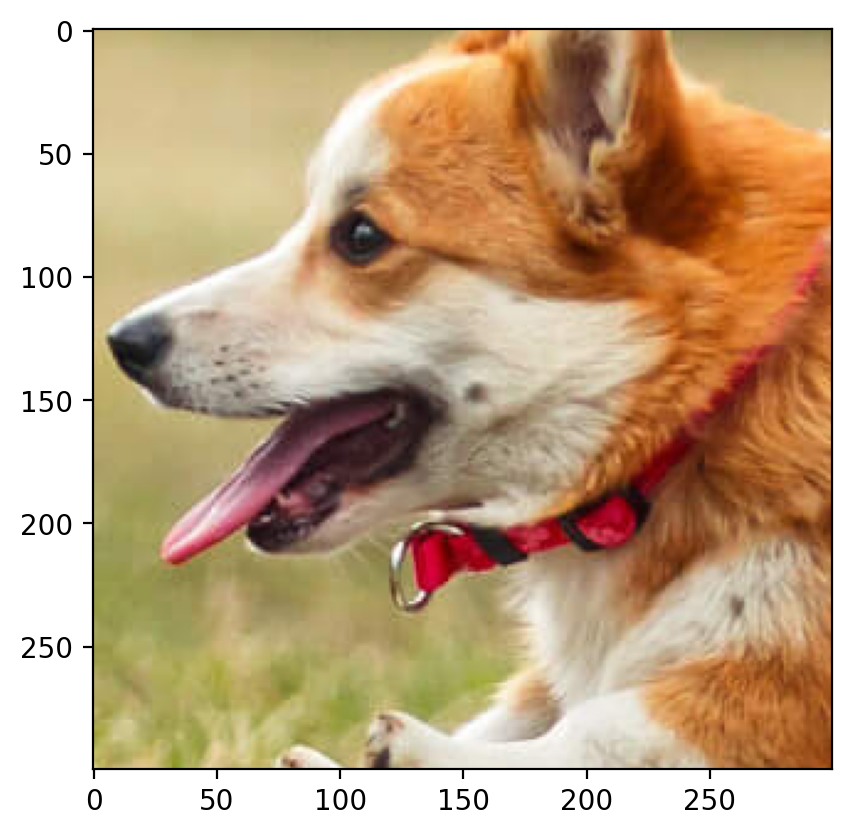

In [6]:
dog = extract_patches(img,(800,600),300,300)
plt.imshow(dog.permute(1,2,0).numpy())

In [7]:
def img_missing_patches(img,top_left,hight,width):
    y,x = top_left
    patches = extract_patches(img,top_left,hight,width)
    patches_copy = patches.clone().float()
    mask = torch.rand(patches.shape) <= 1
    patches_copy[mask] = float('nan')
    img_copy = img.clone().float()
    img_copy[:,x:x+width,y:y+hight] = patches_copy
    return img_copy,patches,patches_copy
# patch_removed_img,patch,patch_copy=img_missing_patches(dog,(0,0),30,30)
# patch_copy

In [8]:
# Function to complete the missing patch
def complete_missing_patch(img, top_left, height, width, k):
    """Complete the missing rectangular patch in the image."""
    # Extract the patches surrounding the missing patch
    x, y = top_left
    img,patch,patch_copy = img_missing_patches(img,top_left,height,width)
    # Factorize the image matrix
    img_re = factorize(img, k)
    # Reconstruct the missing patch using factorized matrices
   
    
    
    return img,img_re,patch


In [9]:
import os
import matplotlib.pyplot as plt

def save_figure(patche,img, completed_img, name, folder="figures"):
    """Save the original and completed images as figures."""
    # Create the directory to store figures if it doesn't exist
    if not os.path.exists(folder):
        os.makedirs(folder)

    # Plot both the original image and the completed image simultaneously
    plt.figure(figsize=(18, 6))  # Adjust the size as needed
    plt.subplot(1, 3, 1)
    plt.imshow(patche.permute(1, 2, 0).numpy().astype('uint8'))
    plt.title('Missing Patch')
    
    plt.subplot(1, 3, 2)
    plt.imshow(img.permute(1, 2, 0).numpy().astype('uint8'))
    plt.title('Original Image')
    
    plt.subplot(1, 3, 3)
    plt.imshow(completed_img.detach().permute(1, 2, 0).numpy().astype('uint8'))
    plt.title('Reconstructed Image')
   
    # Save the figure with the specified name in the folder
    plt.savefig(os.path.join(folder, f"{name}.png"))
    plt.show()
    plt.close()

# Example usage
# Assuming 'img' and 'completed_img' are the original and completed images, respectively
# and 'dog' is your image tensor
# img_const_LS(dog, (0,0), 30, 30, 70, 'Single_color_patch_missing')


In [10]:
def img_const(img,top_left,hight,width,k,name):
    
    img, re_img, patch = complete_missing_patch(img,top_left, hight, width, k)
    save_figure(patch,img, re_img, name)
    return img, re_img

In [11]:
def factorize(A, k, device=torch.device("cpu"), max_iter=3, convergence_threshold=1e-3):
    _,n,m=A.shape
    A = A.to(device)
    # Create a mask to exclude NaN values from computations
    mask_main = ~torch.isnan(A[0])
    
    prev_loss = float('inf')
    lst=[]
    for i in range(3):
        # print(f"Runnng for channel: {i+1}\n")
        W = torch.randint(0,255,size=(n, k), dtype=torch.float32, device=device)
        H = torch.randint(0,255,size=(k, m), dtype=torch.float32, device=device)
        
        prev_loss = float('inf')
        
        for iteration in range(max_iter):
            # Update W
            for j in range(m):
                A_col= A[i,:,j]         
                A_col=A_col.reshape(A_col.shape[0],1)
                mask= ~torch.isnan(A_col)
                if(A_col.isnan().any()):
                    A_=A_col[torch.squeeze(mask)]
                    W_=W[torch.squeeze(mask)]
                else:
                    W_=W
                    A_=A_col
                    
                H[:,j] = torch.linalg.lstsq(W_, A_,rcond=None,driver="gelsy").solution.reshape(k)
            
            # Update H
            H_t=H.t()    
            for j in range(n):
                A_col= A[i][j,:]           
                A_col=A_col.reshape(A_col.shape[0],1)
                mask= ~torch.isnan(A_col)   
                if(A_col.isnan().any()):
                    A_=A_col[torch.squeeze(mask)]
                    H_=H_t[torch.squeeze(mask)]
                else:
                    H_=H_t
                    A_=A_col
                W[j,:]= torch.linalg.lstsq(H_, A_,rcond=None).solution.reshape(k)
                
            diff_matrix = torch.matmul(W, H) - A[i]
            diff_vector = diff_matrix[mask_main]
            loss = torch.norm(diff_vector)
            # if(iteration%10 == 0):
            #     print(loss)
            if iteration > 0 and abs(prev_loss - loss.item()) < convergence_threshold:
                print(f'Converged after {iteration} iterations')
                break
            prev_loss=loss.item()
            # if(iteration % 100 == 0):
            #     print(f"Epoch: {iteration} are Completed.")
        lst.append(torch.clone(torch.matmul(W,H).detach()))
        
    A_re = torch.stack([lst[0],lst[1],lst[2]],dim=0)
    return A_re


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


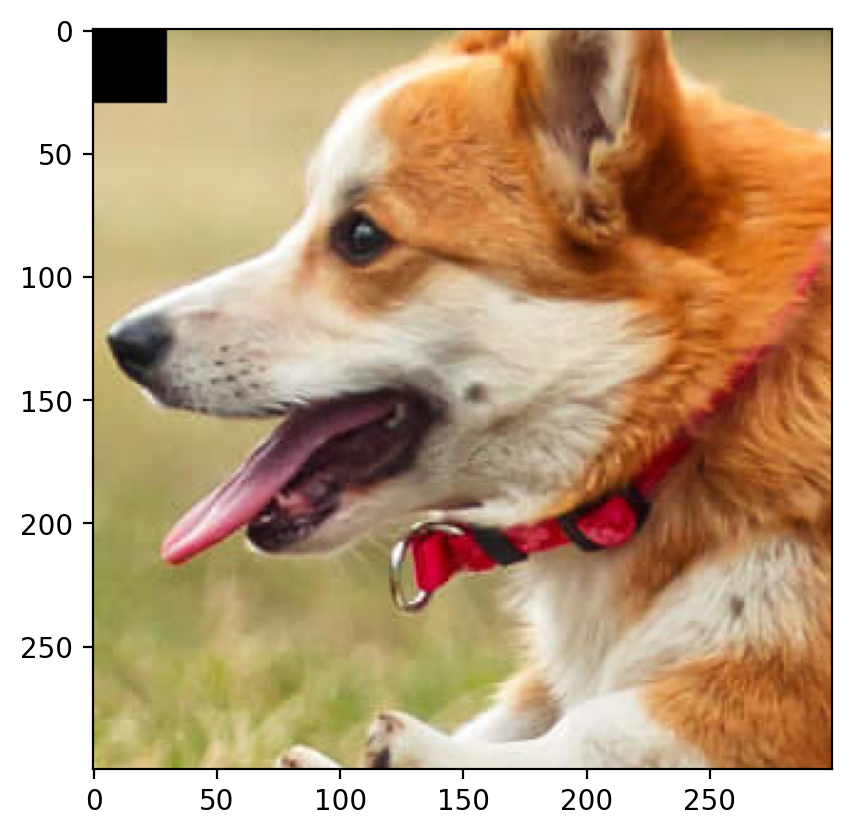

In [12]:
# img,_,_=img_missing_patches(dog,(60,150),30,30)
img,_,_=img_missing_patches(dog,(0,0),30,30)
plt.imshow(img.permute(1,2,0).int().detach().numpy())
plt.show()

In [13]:
# Reconstruction with high iterations
# Max iter 100
img_re=factorize(img,100,max_iter=100)
img_re

tensor([[[350.6327, 323.6155, 340.0771,  ..., 139.2381, 138.3161, 137.3968],
         [344.5570, 318.0973, 333.1324,  ..., 144.9074, 144.8492, 143.8409],
         [328.9191, 304.0562, 318.3315,  ..., 149.6493, 149.2348, 148.2172],
         ...,
         [203.5795, 188.5835, 183.2189,  ..., 149.7988, 145.7151, 139.6392],
         [215.7297, 198.7635, 189.4949,  ..., 154.2706, 144.7735, 141.5408],
         [221.9536, 207.6824, 196.8756,  ..., 159.1661, 147.3940, 146.6775]],

        [[ 69.3047, 101.4893,  78.7189,  ..., 131.5995, 131.9105, 129.4177],
         [ 70.9548, 101.4977,  79.6461,  ..., 134.3266, 134.8016, 133.1837],
         [ 79.0044, 105.0657,  85.1503,  ..., 138.5552, 138.6189, 138.0351],
         ...,
         [195.3227, 181.4306, 175.1499,  ...,  72.4746,  67.9470,  60.0711],
         [206.9842, 191.7421, 181.5728,  ...,  79.8419,  67.7026,  59.0677],
         [213.6917, 200.3883, 188.7053,  ...,  84.6527,  69.1437,  65.5857]],

        [[347.3119, 343.4497, 368.2661,  ...

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


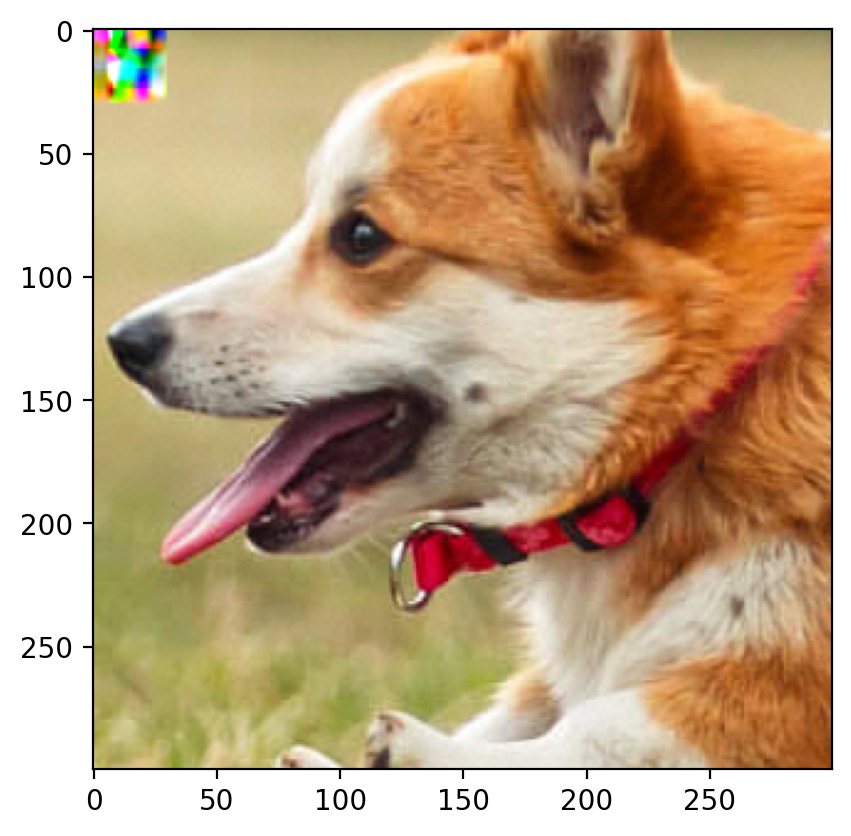

In [14]:
plt.imshow(img_re.permute(1,2,0).int().numpy())
plt.show()

### Image reconstrution with variation in r

In [15]:
img,_,_ = img_missing_patches(dog,(0,0),30,30)
a=factorize(img, 20)
b=factorize(img, 200)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


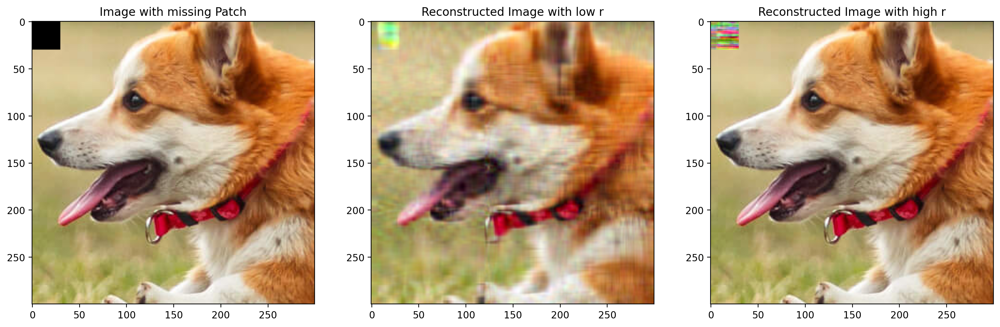

In [16]:
plt.figure(figsize=(18, 6))  
plt.subplot(1, 3, 1)
plt.imshow(img.int().permute(1, 2, 0).numpy())
plt.title('Image with missing Patch')

plt.subplot(1, 3, 2)
plt.imshow(a.int().permute(1, 2, 0).numpy())
plt.title('Reconstructed Image with low r')

plt.subplot(1, 3, 3)
plt.imshow(b.int().permute(1, 2, 0).numpy())
plt.title('Reconstructed Image with high r')

plt.show()
plt.close()

In [17]:
def mask_image(img, width, height):
    img_copy = img.clone().float()
    shape = img.shape
    
    # Generate random indices for masking
    mask_indices = torch.randperm(shape[1] * shape[2])[:width * height]
    
    # Convert indices to 2D coordinates
    mask_indices_2d = torch.unravel_index(mask_indices, (shape[1], shape[2]))
    
    # Create a mask
    mask = torch.zeros((shape[1], shape[2]), dtype=torch.bool)
    mask[mask_indices_2d] = True
    
    # Apply the mask to the image
    for i in range(shape[0]):
        img_copy[i][mask] = float('nan')
    
    return img_copy, mask

In [18]:
import torch

In [19]:
masked_img = mask_image(dog, 30,30)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


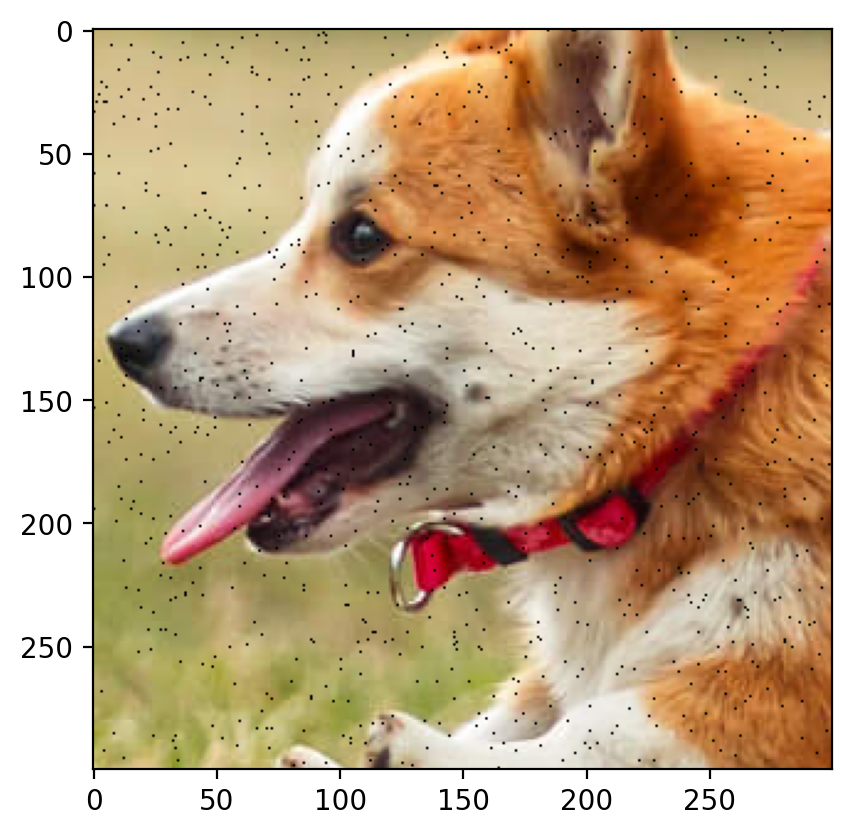

In [20]:
# Ploting masked image with randomly removed pixels 30x30 pixels
plt.imshow(masked_img[0].permute(1,2,0).int().numpy())

C:\Users\patel\AppData\Local\Temp\ipykernel_8348\1508103791.py:17: RuntimeWarning: invalid value encountered in cast
  plt.imshow(img.permute(1, 2, 0).numpy().astype('uint8'))


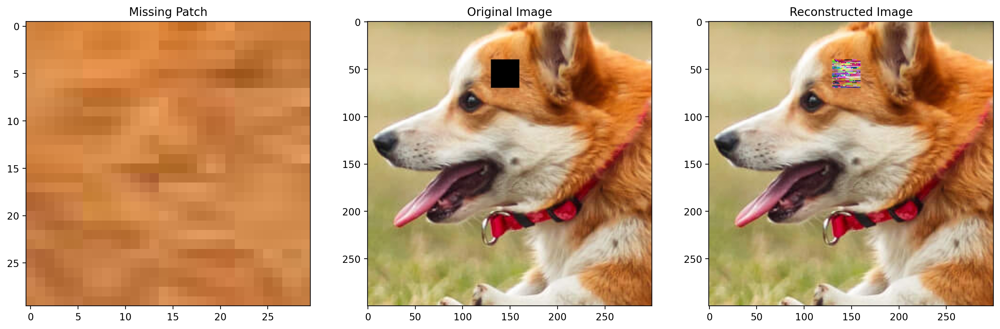

In [21]:
# Reconstruction of image with rectangular patch removed
_,re_img_rect_patch=img_const(dog,(130,40),30,30,200, "Part 1 missing 30x30 Patch")

In [22]:
img_rand_patch_re=factorize(masked_img[0],200,max_iter=3)

C:\Users\patel\AppData\Local\Temp\ipykernel_8348\1508103791.py:13: RuntimeWarning: invalid value encountered in cast
  plt.imshow(patche.permute(1, 2, 0).numpy().astype('uint8'))


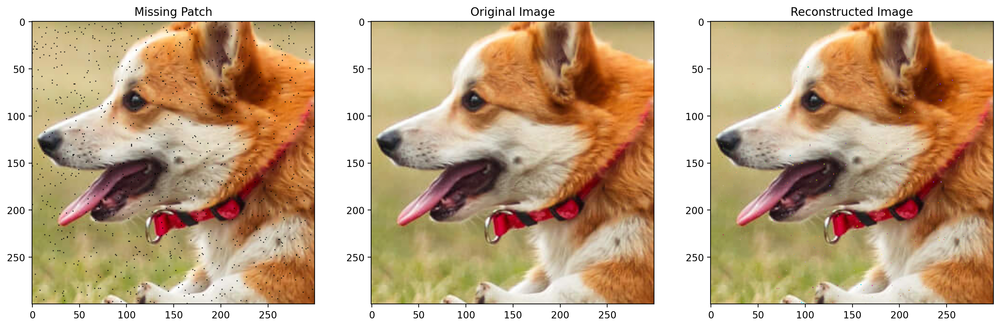

In [23]:
save_figure(masked_img[0],dog,img_rand_patch_re,"Randomly removed patchs reconstruction")

### Metric

In [24]:
# RMSE
def rmse(re_img, original_img):
    mse=np.mean(np.square(re_img-original_img))
    return np.sqrt(mse)

# Peak signal to noise ratio
def psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr


In [25]:
rmse_rect_patch_img=rmse(re_img_rect_patch.numpy(),dog.numpy())
rmse_rand_patch_img=rmse(img_rand_patch_re.numpy(),dog.numpy())
psnr_rect_patch_img=psnr(re_img_rect_patch.numpy(),dog.numpy())
psnr_rand_patch_img=psnr(img_rand_patch_re.numpy(),dog.numpy())
print("RMSE of reconstructon of rect patch removed img ",rmse_rect_patch_img)
print("RMSE of reconstructon of randomly pixels removed img ",rmse_rand_patch_img)

print("\nPSNR of reconstructon of rect patches removed img ",psnr_rect_patch_img)
print("PSNR of reconstructon of randomly pixels removed img ",psnr_rand_patch_img)

RMSE of reconstructon of rect patch removed img  8.260229
RMSE of reconstructon of randomly pixels removed img  2.7412362

PSNR of reconstructon of rect patches removed img  32.91321516036987
PSNR of reconstructon of randomly pixels removed img  39.77106332778931


### Part 2
Vary region size (NxN) for ```N = [20, 40, 60, 80]``` and perform least square instead of Gradient Descent till convergence. Again, consider the two cases for your region as mentioned in Part (a). Demonstrate the variation in reconstruction quality by making appropriate plots and metrics. **[2 Marks]**

C:\Users\patel\AppData\Local\Temp\ipykernel_8348\1508103791.py:17: RuntimeWarning: invalid value encountered in cast
  plt.imshow(img.permute(1, 2, 0).numpy().astype('uint8'))


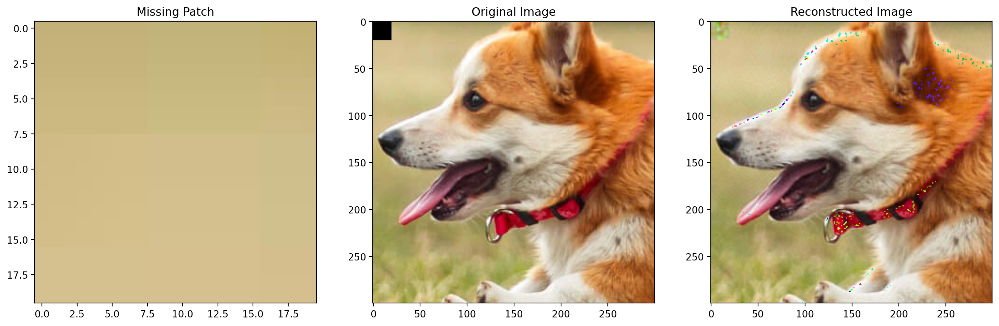

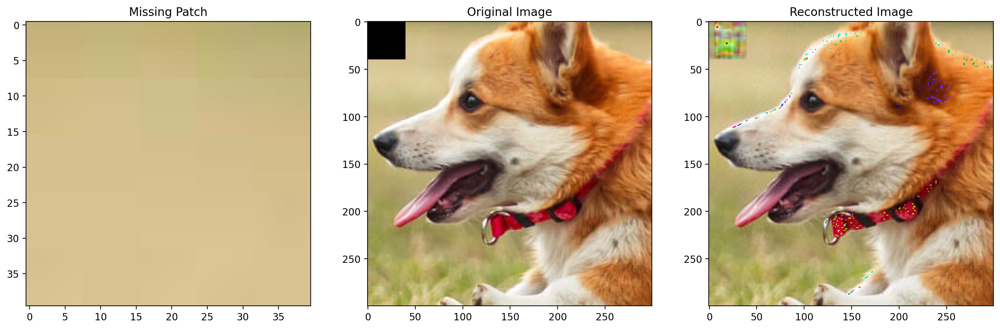

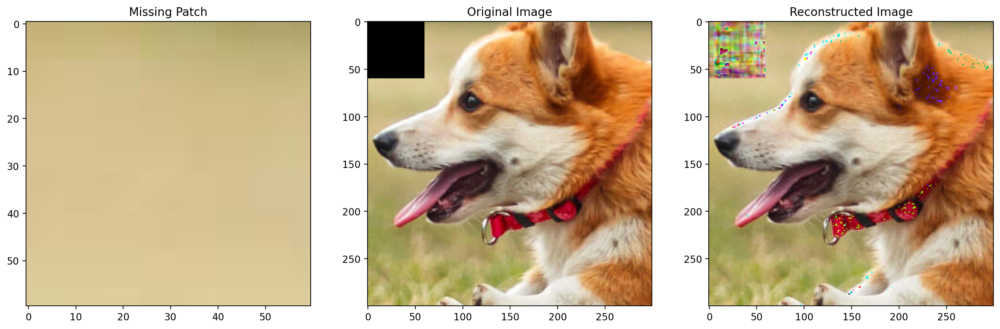

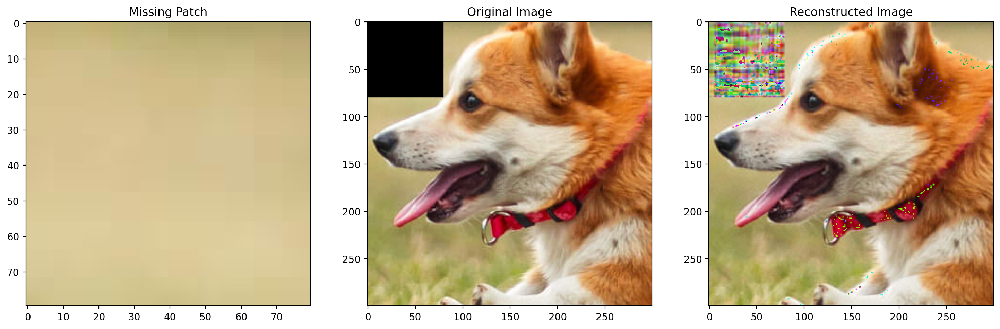

In [26]:
# Reconstruction of image with rectangular patch removed
top_left=(0,0)
height=30
width=30
_,img_rect_patch_re20x20=img_const(dog,top_left,20,20,80, "Part 1 missing 20x20 Patch")
_,img_rect_patch_re40x40=img_const(dog,top_left,40,40,80, "Part 1 missing 40x40 Patch")
_,img_rect_patch_re60x60=img_const(dog,top_left,60,60,80, "Part 1 missing 60x60 Patch")
_,img_rect_patch_re80x80=img_const(dog,top_left,80,80,80, "Part 1 missing 80x80 Patch")


In [27]:
rmse_rect_patch_img20x20=rmse(img_rect_patch_re20x20.numpy(),dog.numpy())
rmse_rect_patch_img40x40=rmse(img_rect_patch_re40x40.numpy(),dog.numpy())
rmse_rect_patch_img60x60=rmse(img_rect_patch_re60x60.numpy(),dog.numpy())
rmse_rect_patch_img80x80=rmse(img_rect_patch_re80x80.numpy(),dog.numpy())

psnr_rect_patch_img20x20=psnr(img_rect_patch_re20x20.numpy(),dog.numpy())
psnr_rect_patch_img40x40=psnr(img_rect_patch_re40x40.numpy(),dog.numpy())
psnr_rect_patch_img60x60=psnr(img_rect_patch_re60x60.numpy(),dog.numpy())
psnr_rect_patch_img80x80=psnr(img_rect_patch_re80x80.numpy(),dog.numpy())


In [28]:
rand_masked_img20x20 = mask_image(dog, 20,20)
rand_masked_img40x40 = mask_image(dog, 40,40)
rand_masked_img60x60 = mask_image(dog, 60,60)
rand_masked_img80x80 = mask_image(dog, 80,80)
rand_masked_img150x150 = mask_image(dog, 150,150)

img_rand_patch_re20x20=factorize(rand_masked_img20x20[0],80)
img_rand_patch_re40x40=factorize(rand_masked_img40x40[0],80)
img_rand_patch_re60x60=factorize(rand_masked_img60x60[0],80)
img_rand_patch_re80x80=factorize(rand_masked_img80x80[0],80)
img_rand_patch_re150x150=factorize(rand_masked_img150x150[0],80)

C:\Users\patel\AppData\Local\Temp\ipykernel_8348\1508103791.py:13: RuntimeWarning: invalid value encountered in cast
  plt.imshow(patche.permute(1, 2, 0).numpy().astype('uint8'))


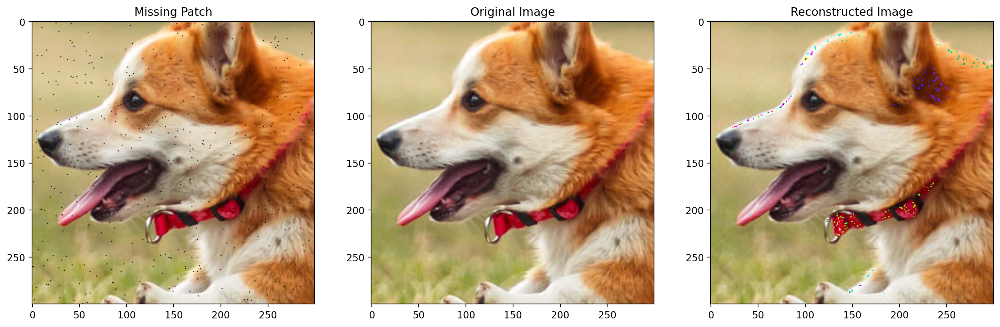

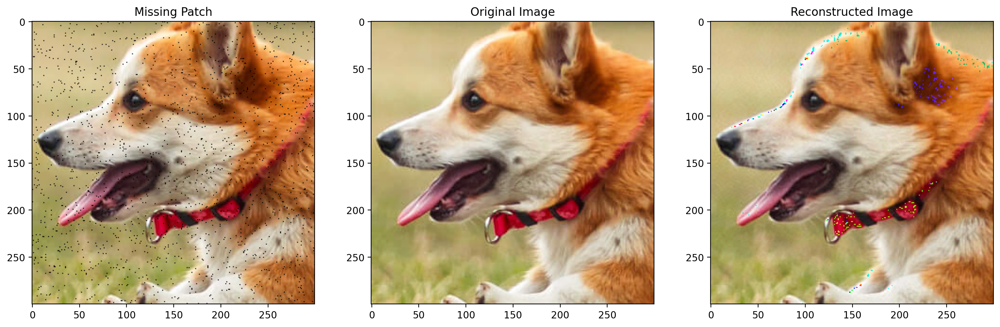

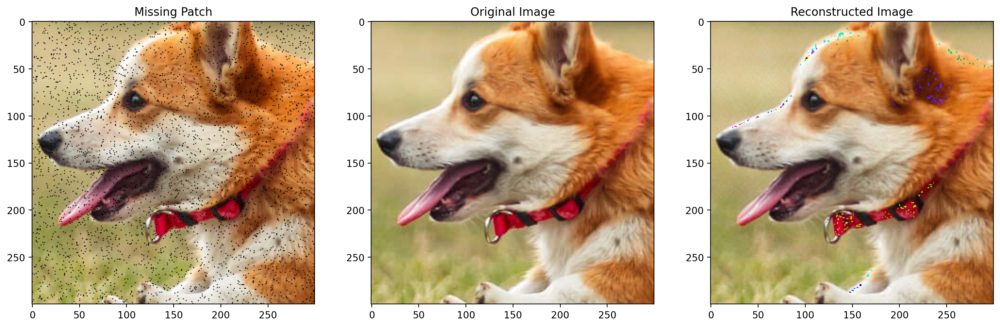

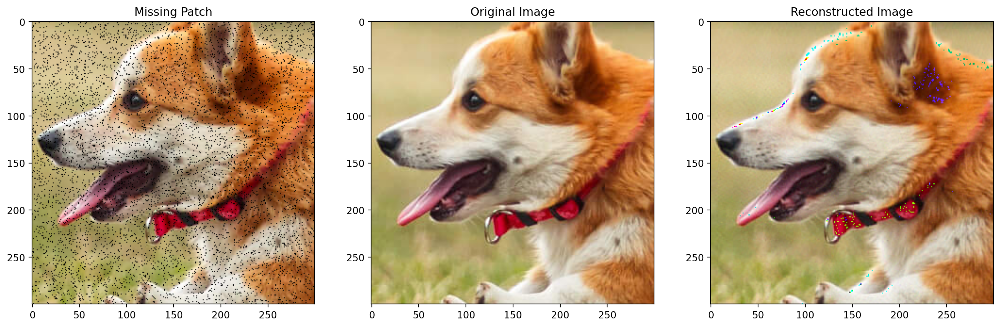

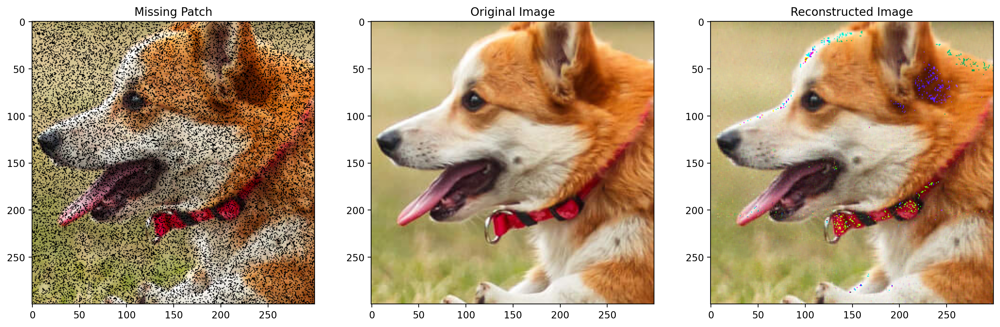

In [29]:
save_figure(rand_masked_img20x20[0],dog,img_rand_patch_re20x20,"Randomly removed 20x20 pixels reconstruction")
save_figure(rand_masked_img40x40[0],dog,img_rand_patch_re40x40,"Randomly removed 40x40 pixels reconstruction")
save_figure(rand_masked_img60x60[0],dog,img_rand_patch_re60x60,"Randomly removed 60x60 pixels reconstruction")
save_figure(rand_masked_img80x80[0],dog,img_rand_patch_re80x80,"Randomly removed 80x80 pixels reconstruction")
save_figure(rand_masked_img150x150[0],dog,img_rand_patch_re150x150,"Randomly removed 150x150 pixels reconstruction")

In [30]:
rmse_rand_patch_img20x20=rmse(img_rand_patch_re20x20.numpy(),dog.numpy())
rmse_rand_patch_img40x40=rmse(img_rand_patch_re40x40.numpy(),dog.numpy())
rmse_rand_patch_img60x60=rmse(img_rand_patch_re60x60.numpy(),dog.numpy())
rmse_rand_patch_img80x80=rmse(img_rand_patch_re80x80.numpy(),dog.numpy())

psnr_rand_patch_img20x20=psnr(img_rand_patch_re20x20.numpy(),dog.numpy())
psnr_rand_patch_img40x40=psnr(img_rand_patch_re40x40.numpy(),dog.numpy())
psnr_rand_patch_img60x60=psnr(img_rand_patch_re60x60.numpy(),dog.numpy())
psnr_rand_patch_img80x80=psnr(img_rand_patch_re80x80.numpy(),dog.numpy())

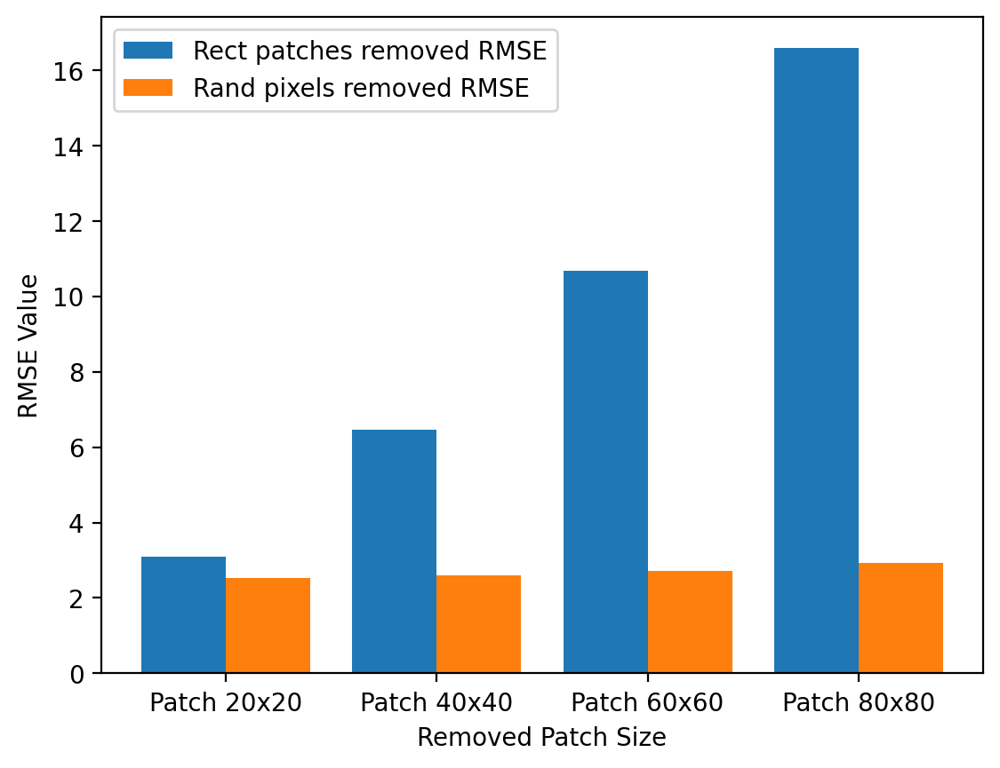

In [31]:
X=["Patch 20x20","Patch 40x40","Patch 60x60","Patch 80x80"]
Y1_rmse=[rmse_rect_patch_img20x20,rmse_rect_patch_img40x40,rmse_rect_patch_img60x60,rmse_rect_patch_img80x80]
Y2_rmse=[rmse_rand_patch_img20x20,rmse_rand_patch_img40x40,rmse_rand_patch_img60x60,rmse_rand_patch_img80x80]
plt.bar(np.arange(len(X))-0.2, Y1_rmse, 0.4,label="Rect patches removed RMSE")
plt.bar(np.arange(len(X))+0.2, Y2_rmse, 0.4,label="Rand pixels removed RMSE")
plt.xticks(np.arange(len(X)),X)
plt.legend()
plt.xlabel("Removed Patch Size")
plt.ylabel("RMSE Value")
plt.show()


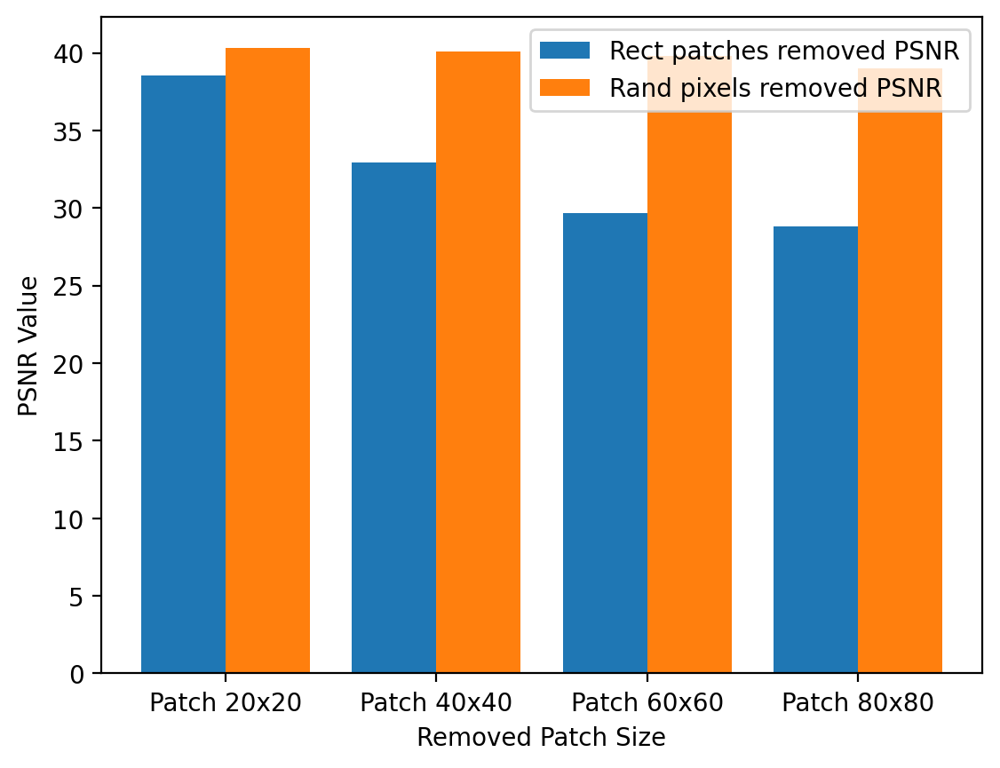

In [32]:
Y1_psnr=[psnr_rect_patch_img20x20, psnr_rect_patch_img40x40, psnr_rect_patch_img60x60, psnr_rect_patch_img80x80]
Y2_psnr=[psnr_rand_patch_img20x20, psnr_rand_patch_img40x40, psnr_rand_patch_img60x60, psnr_rand_patch_img80x80]
plt.bar(np.arange(len(X))-0.2, Y1_psnr, 0.4,label="Rect patches removed PSNR")
plt.bar(np.arange(len(X))+0.2, Y2_psnr, 0.4,label="Rand pixels removed PSNR")
plt.xticks(np.arange(len(X)),X)
plt.legend()
plt.xlabel("Removed Patch Size")
plt.ylabel("PSNR Value")
plt.show()